## Setup

**Note**: this currently requires this fork of transformers: https://github.com/huggingface/transformers/pull/25254

In [1]:
import jax

In [2]:
num_devices = jax.device_count()
device_type = jax.devices()[0].device_kind

print(f"Found {num_devices} JAX devices of type {device_type}.")
assert "TPU" in device_type, "Available device is not a TPU, please select TPU from Edit > Notebook settings > Hardware accelerator"

Found 4 JAX devices of type TPU v4.


In [3]:
import numpy as np
import jax
import jax.numpy as jnp

from pathlib import Path
from jax import pmap
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from PIL import Image

from huggingface_hub import notebook_login
from diffusers import FlaxStableDiffusionXLPipeline

## Model Loading

In [4]:
dtype = jnp.bfloat16

In [5]:
# model_id = "nyxai-lab/sdxl-0.9-flax"

# These are the float32 weights
model_id = "pcuenq/stable-diffusion-xl-base-1.0-flax"

In [6]:
pipeline, params = FlaxStableDiffusionXLPipeline.from_pretrained(
    model_id,
    use_safetensors=True,
    dtype=dtype,
)

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

Keyword arguments {'use_safetensors': True} are not expected by FlaxStableDiffusionXLPipeline and will be ignored.
/home/pedro/code/diffusers/src/diffusers/configuration_utils.py:217: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a model, please use <class 'diffusers.models.unet_2d_condition_flax.FlaxUNet2DConditionModel'>.load_config(...) followed by <class 'diffusers.models.unet_2d_condition_flax.FlaxUNet2DConditionModel'>.from_config(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)
The config attributes {'act_fn': 'silu', 'center_input_sample': False, 'class_embed_type': None, 'class_embeddings_concat': False, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'cross_attention_norm': None, 'downsample_padding': 1, 'dual_cross_attention': False, 'encoder_

Turns out the weights are in `float32` still! Let's convert them. We should merge https://github.com/huggingface/diffusers/pull/4172/files at some point.

In [7]:
params = jax.tree_util.tree_map(lambda x: x.astype(dtype), params)

## Inference

In [8]:
imgs_per_device = 2

In [9]:
# prompt = "a colorful photo of a castle in the middle of a forest with trees and bushes, by Ismail Inceoglu, shadows, high contrast, dynamic shading, hdr, detailed vegetation, digital painting, digital drawing, detailed painting, a detailed digital painting, gothic art, featured on deviantart"
prompt = "photo of a rhino dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography, Elke vogelsang"
prompt = [prompt] * jax.device_count() * imgs_per_device
prompt_ids = pipeline.prepare_inputs(prompt)
prompt_ids.shape

(8, 2, 77)

In [10]:
prompt_ids = shard(prompt_ids)
prompt_ids.shape

(4, 2, 2, 77)

In [11]:
# neg_prompt ="oversaturated, ugly, 3d, render, cartoon, grain, low-res, kitsch"
neg_prompt = "fog, grainy, purple"
neg_prompt = [neg_prompt] * jax.device_count() * imgs_per_device
neg_prompt_ids = pipeline.prepare_inputs(neg_prompt)
neg_prompt_ids.shape

(8, 2, 77)

In [12]:
neg_prompt_ids = shard(neg_prompt_ids)
neg_prompt_ids.shape

(4, 2, 2, 77)

In [13]:
p_params = replicate(params)

In [14]:
def create_key(seed=0):
    return jax.random.PRNGKey(seed)

In [15]:
rng = create_key(0)
rng = jax.random.split(rng, jax.device_count())

In [16]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [17]:
def generate(pipe, params, prompt_ids, neg_prompt_ids, rng, num_inference_steps=25):
    imgs = pipe(
        prompt_ids,
        params,
        rng,
        num_inference_steps=num_inference_steps,
        neg_prompt_ids=neg_prompt_ids,
        guidance_scale = 9.,
        jit=True,
    ).images
    imgs = imgs.reshape((imgs.shape[0] * imgs.shape[1], ) + imgs.shape[-3:])
    return pipe.numpy_to_pil(np.array(imgs))

In [39]:
%%time

images = generate(pipeline, p_params, prompt_ids, neg_prompt_ids, rng, num_inference_steps=20)
images = images.block_until_
len(images)

CPU times: user 543 ms, sys: 42.3 ms, total: 585 ms
Wall time: 4.47 s


8

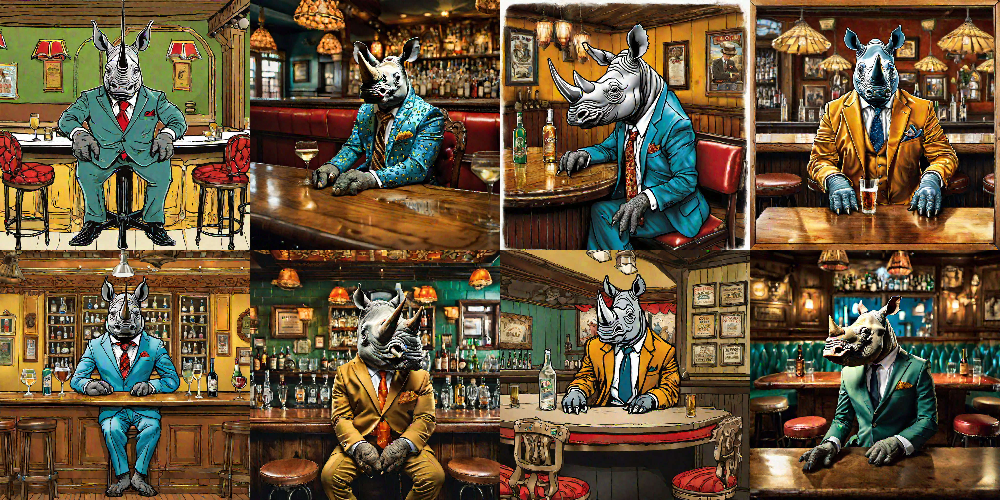

In [19]:
image_grid(images, 2, len(images)//2)

Some of these look more like illustrations than the previous version without the projection version of the text encoder. Or is it because the 0.9 vs 1.0 weights? To be investigated.

## Refiner

In [20]:
from diffusers import FlaxStableDiffusionXLImg2ImgPipeline

In [21]:
refiner, refiner_params = FlaxStableDiffusionXLImg2ImgPipeline.from_pretrained(
    "pcuenq/stable-diffusion-xl-refiner-1.0-flax",
    dtype=jnp.bfloat16,
)

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

The config attributes {'force_zeros_for_empty_prompt': False, 'text_encoder': [None, None], 'tokenizer': [None, None]} were passed to FlaxStableDiffusionXLImg2ImgPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'force_zeros_for_empty_prompt': False, 'text_encoder': [None, None], 'tokenizer': [None, None]} are not expected by FlaxStableDiffusionXLImg2ImgPipeline and will be ignored.
The config attributes {'act_fn': 'silu', 'center_input_sample': False, 'class_embed_type': None, 'class_embeddings_concat': False, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'cross_attention_norm': None, 'downsample_padding': 1, 'dual_cross_attention': False, 'encoder_hid_dim': None, 'encoder_hid_dim_type': None, 'mid_block_only_cross_attention': None, 'mid_block_scale_factor': 1, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'norm_eps': 1e-05, 'norm_num_groups': 32, 'num_class_embeds': None, 'resnet_out_scale_factor': 1.0, 'resnet_

In [22]:
del refiner_params["vae"]
del refiner_params["text_encoder_2"]

In [23]:
refiner_params = jax.tree_util.tree_map(lambda x: x.astype(dtype), refiner_params)

In [24]:
refiner_params["vae"] = params["vae"]
refiner_params["text_encoder_2"] = params["text_encoder_2"]

In [25]:
p_refiner_params = replicate(refiner_params)

In [26]:
r_prompt_ids, r_images = refiner.prepare_inputs(
    prompt=prompt, image=images
)

In [27]:
len(images), images[0].size, r_images.shape

(8, (1024, 1024), (8, 3, 1024, 1024))

In [28]:
r_neg_prompt_ids = refiner.prepare_text_inputs(neg_prompt)

In [29]:
r_images = shard(r_images)
r_images.shape

(4, 2, 3, 1024, 1024)

In [30]:
r_prompt_ids = shard(r_prompt_ids)
r_neg_prompt_ids = shard(r_neg_prompt_ids)
r_prompt_ids.shape, r_neg_prompt_ids.shape

((4, 2, 1, 77), (4, 2, 1, 77))

In [41]:
%%time

refined_images = refiner(
    prompt_ids=r_prompt_ids,
    image=r_images,
    params=p_refiner_params,
    prng_seed=rng,
    num_inference_steps=20,
    neg_prompt_ids=r_neg_prompt_ids,
    jit=True,
).images

# refined_images = refined_images.block_until_ready()

refined_images = refined_images.reshape((refined_images.shape[0] * refined_images.shape[1], ) + refined_images.shape[-3:])
refined_images = refiner.numpy_to_pil(np.array(refined_images))

start_timestep: 14, num_inference_steps: 20
CPU times: user 540 ms, sys: 15.4 ms, total: 555 ms
Wall time: 2.16 s


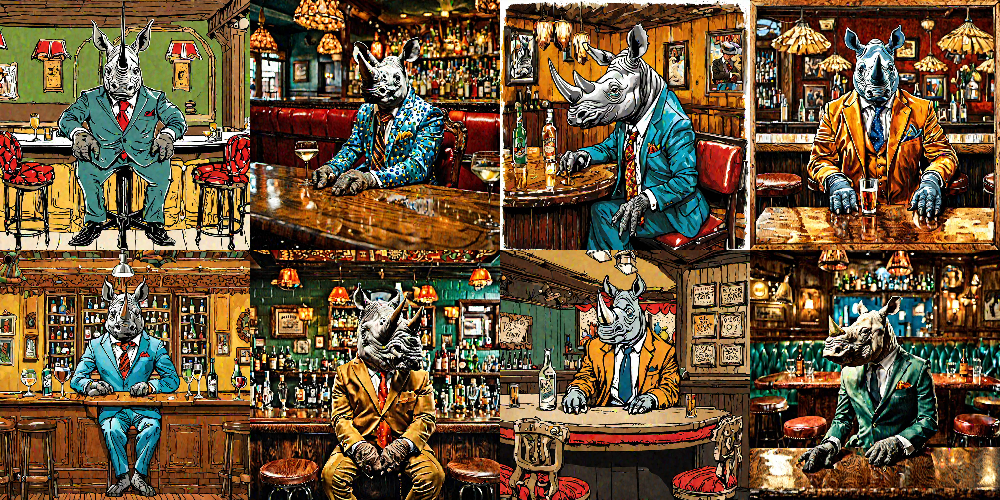

In [42]:
image_grid(refined_images, 2, len(refined_images)//2)